In [1]:
from pprint import pprint
import numpy as np
import numpy as np
import scipy.signal as signal
import matplotlib.pyplot as plt
from scipy.io import loadmat
import sys

In [2]:
dataset_path = "/mnt/Velocity_Vault/ECG/Data/WFDB"

In [3]:
import os

def create_hea_and_mat_arrays(folder_path):
    """
    Creates hea_array and mat_array with file paths named HR<n>.hea and HR<n>.mat.

    Parameters:
        folder_path (str): The folder containing the files.

    Returns:
        tuple: Two lists - hea_array and mat_array.
    """
    hea_array = {}
    mat_array = {}

    # Iterate through all files in the folder
    for file_name in os.listdir(folder_path):
        # Check for valid filenames
        if len(file_name) == 11 and file_name.startswith("HR") and file_name[2:7].isdigit():
            file_index=int(file_name[2:7])
            file_path = os.path.join(folder_path, file_name)
            if file_name.endswith(".hea"):
                hea_array[file_index]=file_path
            elif file_name.endswith(".mat"):
                mat_array[file_index]=file_path

    return hea_array, mat_array


hea_dict, mat_dict = create_hea_and_mat_arrays(dataset_path)

def dict_to_array(my_dict):
    # Create an array large enough to hold the largest key
    max_key = max(my_dict.keys())
    array = [None] * (max_key + 1)

    # Place values in the array based on the keys
    for key, value in my_dict.items():
        array[key] = value

    return array

hea_array=dict_to_array(hea_dict)
mat_array=dict_to_array(mat_dict)

print("HEA Array:", len(hea_array))
print("MAT Array:",len(mat_array))
pprint(hea_array)
pprint(mat_array)


HEA Array: 21838
MAT Array: 21838
[None,
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00001.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00002.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00003.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00004.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00005.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00006.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00007.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00008.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00009.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00010.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00011.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00012.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00013.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00014.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00015.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00016.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00017.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00018.hea',
 '/mnt/Velocity_Vault/ECG/Data/WFDB/HR00019.hea',
 '/mnt/Ve

In [4]:
import re

def parse_header_file(file_path):
    # Initialize a dictionary to store the parsed data
    data_dict = {}

    # Open and read the .hea file
    with open(file_path, 'r') as file:
        lines = file.readlines()

    # Parse the first line for general information (ID, sample rate, etc.)
    first_line = lines[0].strip()
    first_line_parts = first_line.split()
    data_dict['Recording_ID'] = first_line_parts[0]
    data_dict['Num_Leads'] = int(first_line_parts[1])
    data_dict['Sampling_Rate_Hz'] = int(first_line_parts[2])
    data_dict['Num_Samples'] = int(first_line_parts[3])

    # Parse the subsequent lines for lead-specific information
    lead_info = []
    for i in range(1, data_dict['Num_Leads'] + 1):
        lead_line = lines[i].strip()
        lead_parts = lead_line.split()
        lead_data = {
            'File_Name': lead_parts[0],
            'Bit_Depth': lead_parts[1],
            'Gain_mV': lead_parts[2],
            'ADC_Resolution': int(lead_parts[3]),
            'Baseline': int(lead_parts[4]),
            'Signal_Offset': int(lead_parts[5]),
            'Lead_Type': lead_parts[6]
        }
        lead_info.append(lead_data)
    
    data_dict['Leads'] = lead_info

    # Parse the last few lines for patient information
    patient_info = {}
    for line in lines[data_dict['Num_Leads'] + 1:]:
        line = line.strip()
        if line.startswith('#Age:'):
            patient_info['Age'] = line.split(":")[1].strip()
        elif line.startswith('#Sex:'):
            patient_info['Sex'] = line.split(":")[1].strip()
        elif line.startswith('#Dx:'):
            patient_info['Diagnosis_Code'] = line.split(":")[1].strip()

    data_dict['Patient_Info'] = patient_info

    return data_dict


hea_dict=parse_header_file(hea_array[67])
pprint(hea_dict)

{'Leads': [{'ADC_Resolution': 16,
            'Baseline': 0,
            'Bit_Depth': '16+24',
            'File_Name': 'HR00067.mat',
            'Gain_mV': '1000/mv',
            'Lead_Type': '920',
            'Signal_Offset': 130},
           {'ADC_Resolution': 16,
            'Baseline': 0,
            'Bit_Depth': '16+24',
            'File_Name': 'HR00067.mat',
            'Gain_mV': '1000/mv',
            'Lead_Type': '-3820',
            'Signal_Offset': 240},
           {'ADC_Resolution': 16,
            'Baseline': 0,
            'Bit_Depth': '16+24',
            'File_Name': 'HR00067.mat',
            'Gain_mV': '1000/mv',
            'Lead_Type': '-4698',
            'Signal_Offset': 110},
           {'ADC_Resolution': 16,
            'Baseline': 0,
            'Bit_Depth': '16+24',
            'File_Name': 'HR00067.mat',
            'Gain_mV': '1000/mv',
            'Lead_Type': '1948',
            'Signal_Offset': -185},
           {'ADC_Resolution': 16,
            'Bas

In [5]:

import numpy as np
import pandas as pd
import scipy.io
import matplotlib.pyplot as plt
import sys
from scipy import signal as sg

class Pan_Tompkins_QRS:
    def __init__(self, fs):
        self.fs = fs  # Sampling frequency (fs) passed as an argument

    def band_pass_filter(self, signal):
        result = None
        sig = signal.copy()

        # Low-pass filter (11 Hz cutoff)
        for index in range(len(signal)):
            sig[index] = signal[index]
            if (index >= 1):
                sig[index] += 2*sig[index-1]
            if (index >= 2):
                sig[index] -= sig[index-2]
            if (index >= 6):
                sig[index] -= 2*signal[index-6]
            if (index >= 12):
                sig[index] += signal[index-12]

        result = sig.copy()

        # High-pass filter (5 Hz cutoff)
        for index in range(len(signal)):
            result[index] = -1*sig[index]
            if (index >= 1):
                result[index] -= result[index-1]
            if (index >= 16):
                result[index] += 32*sig[index-16]
            if (index >= 32):
                result[index] += sig[index-32]

        # Normalize the result
        max_val = max(max(result), -min(result))
        result = result / max_val
        return result

    def derivative(self, signal):
        result = signal.copy()
        for index in range(len(signal)):
            result[index] = 0
            if (index >= 1):
                result[index] -= 2*signal[index-1]
            if (index >= 2):
                result[index] -= signal[index-2]
            if (index >= 2 and index <= len(signal)-2):
                result[index] += 2*signal[index+1]
            if (index >= 2 and index <= len(signal)-3):
                result[index] += signal[index+2]
            result[index] = (result[index] * self.fs) / 8  # Use self.fs instead of annotation.fs
        return result

    def squaring(self, signal):
        result = signal.copy()
        for index in range(len(signal)):
            result[index] = signal[index]**2
        return result

    def moving_window_integration(self, signal):
        result = signal.copy()
        win_size = round(0.150 * self.fs)

        # If the signal length is smaller than the win_size, use the signal length
        if len(signal) < win_size:
            win_size = len(signal)

        sum = 0
        for j in range(win_size):
            sum += signal[j] / win_size
            result[j] = sum

        for index in range(win_size, len(signal)):
            sum += signal[index] / win_size
            sum -= signal[index - win_size] / win_size
            result[index] = sum

        return result

    def solve(self, signal):
        input_signal = signal.iloc[:, 1].to_numpy()

        # Bandpass Filter
        bpass = self.band_pass_filter(input_signal.copy())

        # Derivative Function
        der = self.derivative(bpass.copy())

        # Squaring Function
        sqr = self.squaring(der.copy())

        # Moving Window Integration Function
        mwin = self.moving_window_integration(sqr.copy())

        return bpass,mwin


# Update process_ecg to adjust signal using Signal_Offset and Gain_mV from hea_dict
def preprocess_ecg(hea_dict, raw_ecg):
    #return raw_ecg
    # Create a dictionary of offsets and gains for each lead
    leads_info = hea_dict['Leads']
    
    processed_signals = []
    
    for i, lead in enumerate(leads_info):
        signal_offset = lead['Signal_Offset']
        gain_mv = int(lead['Gain_mV'].replace("/mv", ""))  # Gain in mV
        
        # Adjust the raw ECG signal for this lead by applying offset and gain
        adjusted_signal = (raw_ecg[i] + signal_offset) * gain_mv / 1000  # Scale to mV
        
        processed_signals.append(adjusted_signal)
    
    return processed_signals

def process_ecg(hea_dict, signal):
    # Load the .mat ECG signal data
    # Preprocess the ECG signals using the header information
    processed_signals = preprocess_ecg(hea_dict, signal)

    # Extract fs (sampling frequency) from the header
    fs = hea_dict['Sampling_Rate_Hz']  # Assuming it's present in the header file
    #print("Fs : ",fs)
    # Initialize QRS detector with fs
    QRS_detector = Pan_Tompkins_QRS(fs)

    # Solve using Pan-Tompkins algorithm for all signals
    processed_signals_qrs = [QRS_detector.solve(pd.DataFrame({'Time': range(len(signal)), 'ECG': signal})) for signal in processed_signals]

    return processed_signals_qrs


def load_mat_file(mat_path):
    # Load the .mat file using scipy.io
    mat_data = scipy.io.loadmat(mat_path)
    # Assuming the ECG signal is stored in 'ecg' key or similar
    ecg_signal = mat_data['val']  # Replace 'ecg' with the actual key if different
    return ecg_signal




# Example usage:
test_file = 5016
hea_dict = parse_header_file(hea_array[test_file])
mat_path = mat_array[test_file]

disease=(hea_dict["Patient_Info"]["Diagnosis_Code"]).split(',')
print(disease)
signal = load_mat_file(mat_path)  # Assuming this loads all ECG signals for all leads

processed_ecg= process_ecg(hea_dict, signal)

print(sys.getsizeof(process_ecg))

print(np.array(processed_ecg).shape)



['164889003', '713426002']
152
(12, 2, 5000)


In [6]:
# Importing Libraries
from scipy import signal as sg

class heart_rate():

  def __init__(self,signal,samp_freq,bpass,mwin):
    '''
    Initialize Variables
    :param signal: input signal
    :param samp_freq: sample frequency of input signal
    '''

    # Initialize variables
    self.RR1, self.RR2, self.probable_peaks, self.r_locs, self.peaks, self.result = ([] for i in range(6))
    self.SPKI, self.NPKI, self.Threshold_I1, self.Threshold_I2, self.SPKF, self.NPKF, self.Threshold_F1, self.Threshold_F2 = (0 for i in range(8))

    self.T_wave = False          
    self.m_win = mwin
    self.b_pass = bpass
    self.samp_freq = samp_freq
    self.signal = signal
    self.win_150ms = round(0.15*self.samp_freq)

    self.RR_Low_Limit = 0
    self.RR_High_Limit = 0
    self.RR_Missed_Limit = 0
    self.RR_Average1 = 0


  def approx_peak(self):
    '''
    Approximate peak locations
    '''   

    # FFT convolution
    slopes = sg.fftconvolve(self.m_win, np.full((25,), 1) / 25, mode='same')

    # Finding approximate peak locations
    for i in range(round(0.5*self.samp_freq) + 1,len(slopes)-1):
        if (slopes[i] > slopes[i-1]) and (slopes[i+1] < slopes[i]):
            self.peaks.append(i)  


  def adjust_rr_interval(self,ind):
    '''
    Adjust RR Interval and Limits
    :param ind: current index in peaks array
    '''

    # Finding the eight most recent RR intervals
    self.RR1 = np.diff(self.peaks[max(0,ind - 8) : ind + 1])/self.samp_freq   

    # Calculating RR Averages
    self.RR_Average1 = np.mean(self.RR1)
    RR_Average2 = self.RR_Average1
      
    # Finding the eight most recent RR intervals lying between RR Low Limit and RR High Limit  
    if (ind >= 8):
        for i in range(0, 8):
            if (self.RR_Low_Limit < self.RR1[i] < self.RR_High_Limit): 
                self.RR2.append(self.RR1[i])

                if (len(self.RR2) > 8):
                    self.RR2.remove(self.RR2[0])
                    RR_Average2 = np.mean(self.RR2)    

    # Adjusting the RR Low Limit and RR High Limit
    if (len(self.RR2) > 7 or ind < 8):
        self.RR_Low_Limit = 0.92 * RR_Average2        
        self.RR_High_Limit = 1.16 * RR_Average2
        self.RR_Missed_Limit = 1.66 * RR_Average2


  def searchback(self,peak_val,RRn,sb_win):
      '''
      Searchback
      :param peak_val: peak location in consideration
      :param RRn: the most recent RR interval
      :param sb_win: searchback window
      '''

      # Check if the most recent RR interval is greater than the RR Missed Limit
      if (RRn > self.RR_Missed_Limit):
          # Initialize a window to searchback  
          win_rr = self.m_win[peak_val - sb_win + 1 : peak_val + 1] 

          # Find the x locations inside the window having y values greater than Threshold I1             
          coord = np.asarray(win_rr > self.Threshold_I1).nonzero()[0]

          # Find the x location of the max peak value in the search window
          if (len(coord) > 0):
              for pos in coord:
                  if (win_rr[pos] == max(win_rr[coord])):
                      x_max = pos
                      break
          else:
            x_max = None
 
          # If the max peak value is found
          if (x_max is not None):   
            # Update the thresholds corresponding to moving window integration
            self.SPKI = 0.25 * self.m_win[x_max] + 0.75 * self.SPKI                         
            self.Threshold_I1 = self.NPKI + 0.25 * (self.SPKI - self.NPKI)
            self.Threshold_I2 = 0.5 * self.Threshold_I1         

            # Initialize a window to searchback 
            win_rr = self.b_pass[x_max - self.win_150ms: min(len(self.b_pass) -1, x_max)]  

            # Find the x locations inside the window having y values greater than Threshold F1                   
            coord = np.asarray(win_rr > self.Threshold_F1).nonzero()[0]

            # Find the x location of the max peak value in the search window
            if (len(coord) > 0):
              for pos in coord:
                  if (win_rr[pos] == max(win_rr[coord])):
                      r_max = pos
                      break
            else:
              r_max = None

            # If the max peak value is found
            if (r_max is not None):
              # Update the thresholds corresponding to bandpass filter
              if self.b_pass[r_max] > self.Threshold_F2:                                                        
                  self.SPKF = 0.25 * self.b_pass[r_max] + 0.75 * self.SPKF                            
                  self.Threshold_F1 = self.NPKF + 0.25 * (self.SPKF - self.NPKF)
                  self.Threshold_F2 = 0.5 * self.Threshold_F1      

                  # Append the probable R peak location                      
                  self.r_locs.append(r_max)                                                


  def find_t_wave(self,peak_val,RRn,ind,prev_ind):
    '''
    T Wave Identification
    :param peak_val: peak location in consideration
    :param RRn: the most recent RR interval
    :param ind: current index in peaks array
    :param prev_ind: previous index in peaks array
    '''

    if (self.m_win[peak_val] >= self.Threshold_I1): 
        if (ind > 0 and 0.20 < RRn < 0.36):
          # Find the slope of current and last waveform detected        
          curr_slope = max(np.diff(self.m_win[peak_val - round(self.win_150ms/2) : peak_val + 1]))
          last_slope = max(np.diff(self.m_win[self.peaks[prev_ind] - round(self.win_150ms/2) : self.peaks[prev_ind] + 1]))
          
          # If current waveform slope is less than half of last waveform slope
          if (curr_slope < 0.5*last_slope):  
              # T Wave is found and update noise threshold                      
              self.T_wave = True                             
              self.NPKI = 0.125 * self.m_win[peak_val] + 0.875 * self.NPKI 

        if (not self.T_wave):
            # T Wave is not found and update signal thresholds
            if (self.probable_peaks[ind] > self.Threshold_F1):   
                self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI                                         
                self.SPKF = 0.125 * self.b_pass[ind] + 0.875 * self.SPKF 

                # Append the probable R peak location
                self.r_locs.append(self.probable_peaks[ind])  

            else:
                self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI
                self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF                   

    # Update noise thresholds
    elif (self.m_win[peak_val] < self.Threshold_I1) or (self.Threshold_I1 < self.m_win[peak_val] < self.Threshold_I2):
        self.NPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.NPKI  
        self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF


  def adjust_thresholds(self,peak_val,ind):
    '''
    Adjust Noise and Signal Thresholds During Learning Phase
    :param peak_val: peak location in consideration
    :param ind: current index in peaks array
    '''

    if (self.m_win[peak_val] >= self.Threshold_I1): 
        # Update signal threshold
        self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI

        if (self.probable_peaks[ind] > self.Threshold_F1):                                            
            self.SPKF = 0.125 * self.b_pass[ind] + 0.875 * self.SPKF 

            # Append the probable R peak location
            self.r_locs.append(self.probable_peaks[ind])  

        else:
            # Update noise threshold
            self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF                                    
        
    # Update noise thresholds    
    elif (self.m_win[peak_val] < self.Threshold_I2) or (self.Threshold_I2 < self.m_win[peak_val] < self.Threshold_I1):
        self.NPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.NPKI  
        self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF


  def update_thresholds(self):
    '''
    Update Noise and Signal Thresholds for next iteration
    '''

    self.Threshold_I1 = self.NPKI + 0.25 * (self.SPKI - self.NPKI)
    self.Threshold_F1 = self.NPKF + 0.25 * (self.SPKF - self.NPKF)
    self.Threshold_I2 = 0.5 * self.Threshold_I1 
    self.Threshold_F2 = 0.5 * self.Threshold_F1
    self.T_wave = False 


  def ecg_searchback(self):
    '''
    Searchback in ECG signal to increase efficiency
    '''

    # Filter the unique R peak locations
    self.r_locs = np.unique(np.array(self.r_locs).astype(int))

    # Initialize a window to searchback
    win_200ms = round(0.2*self.samp_freq)
   
    for r_val in self.r_locs:
        coord = np.arange(r_val - win_200ms, min(len(self.signal), r_val + win_200ms + 1), 1)

        # Find the x location of the max peak value
        if (len(coord) > 0):
          for pos in coord:
              if (self.signal[pos] == max(self.signal[coord])):
                  x_max = pos
                  break
        else:
          x_max = None

        # Append the peak location
        if (x_max is not None):   
          self.result.append(x_max)


  def find_r_peaks(self):
    '''
    R Peak Detection
    '''

    # Find approximate peak locations
    self.approx_peak()

    # Iterate over possible peak locations
    for ind in range(len(self.peaks)):

        # Initialize the search window for peak detection
        peak_val = self.peaks[ind]
        win_300ms = np.arange(max(0, self.peaks[ind] - self.win_150ms), min(self.peaks[ind] + self.win_150ms, len(self.b_pass)-1), 1)
        max_val = max(self.b_pass[win_300ms], default = 0)

        # Find the x location of the max peak value
        if (max_val != 0):        
          x_coord = np.asarray(self.b_pass == max_val).nonzero()
          self.probable_peaks.append(x_coord[0][0])
        
        if (ind < len(self.probable_peaks) and ind != 0):
            # Adjust RR interval and limits
            self.adjust_rr_interval(ind)
            
            # Adjust thresholds in case of irregular beats
            if (self.RR_Average1 < self.RR_Low_Limit or self.RR_Average1 > self.RR_Missed_Limit): 
                self.Threshold_I1 /= 2
                self.Threshold_F1 /= 2

            RRn = self.RR1[-1]

            # Searchback
            self.searchback(peak_val,RRn,round(RRn*self.samp_freq))

            # T Wave Identification
            self.find_t_wave(peak_val,RRn,ind,ind-1)

        else:
          # Adjust threholds
          self.adjust_thresholds(peak_val,ind)

        # Update threholds for next iteration
        self.update_thresholds()

    # Searchback in ECG signal 
    self.ecg_searchback()

    return self.result

In [7]:
from scipy.signal import find_peaks

def find_p_peaks(ecg_signal, r_peaks, sampling_rate=500, p_wave_window=150):
    """
    Detect P-peaks in an ECG signal based on R-peak locations.

    :param ecg_signal: 1D array or list of the ECG signal.
    :param r_peaks: List of R-peak indices.
    :param sampling_rate: Sampling rate of the ECG signal in Hz.
    :param p_wave_window: Time window before each R-peak to search for P-peaks (in ms).
    :return: List of P-peak indices.
    """
    # Convert the P-wave window from ms to samples
    p_wave_window_samples = int((p_wave_window / 1000) * sampling_rate)
    p_peaks = []

    for r_peak in r_peaks:
        # Define the P-wave search region (before the R-peak)
        start_idx = max(0, r_peak - p_wave_window_samples)
        end_idx = r_peak

        # Extract the segment of the signal for P-wave detection
        p_wave_region = ecg_signal[start_idx:end_idx]

        # Detect peaks in the P-wave region
        peaks, _ = find_peaks(p_wave_region)

        if len(peaks) > 0:
            # Find the peak with the maximum amplitude (assume it corresponds to the P-wave)
            p_peak_idx = peaks[np.argmax(p_wave_region[peaks])]
            p_peaks.append(start_idx + p_peak_idx)

    return p_peaks

In [8]:
import numpy as np

def find_t_peaks(ecg_signal, r_peaks, fs=500, t_window=(0.15, 0.4)):
    """
    Find T-peaks in an ECG signal.

    :param ecg_signal: The ECG signal (array or list).
    :param r_peaks: Indices of detected R-peaks.
    :param fs: Sampling frequency of the signal (in Hz).
    :param t_window: Time window after R-peaks to search for T-peaks (in seconds).
    :return: List of indices of T-peaks.
    """
    t_peaks = []
    search_start_offset = int(t_window[0] * fs)  # Convert seconds to samples
    search_end_offset = int(t_window[1] * fs)    # Convert seconds to samples

    for r_peak in r_peaks:
        # Define the search window for the T-wave
        search_start = r_peak + search_start_offset
        search_end = r_peak + search_end_offset

        # Ensure the search window is within signal bounds
        if search_start >= len(ecg_signal) or search_end > len(ecg_signal):
            break

        # Extract the segment where the T-wave is expected
        t_wave_segment = ecg_signal[search_start:search_end]

        # Find the index of the maximum amplitude in the segment
        t_peak_relative = np.argmax(t_wave_segment)
        t_peak = search_start + t_peak_relative

        t_peaks.append(t_peak)

    return t_peaks


In [9]:
import numpy as np
import pyentrp.entropy as ent

def compute_mpe(signal, m, delay, scales):
    """
    Compute Multiscale Permutation Entropy (MPE) for a given signal.
    
    :param signal: 1D array or list of signal values.
    :param m: Embedding dimension for PE.
    :param delay: Time delay for PE.
    :param scales: List of scales for multiscale PE calculation.
    :return: List of MPE values for each scale.
    """
    mpe_values = []
    for scale in scales:
        # Coarse-grain the signal for the current scale
        coarse_grained = np.mean(signal[:len(signal)//scale * scale].reshape(-1, scale), axis=1)
        # Compute Permutation Entropy for the coarse-grained signal
        mpe_values.append(ent.permutation_entropy(coarse_grained, order=m, delay=delay))
    return mpe_values

def t_wave_mpe(ecg_signal, t_peaks, fs=500, window_size=0.2, m=3, delay=1, scales=[1, 2, 3, 4, 5]):
    """
    Compute T-wave Multiscale Permutation Entropy (MPE) for an ECG signal.
    
    :param ecg_signal: The ECG signal (array or list).
    :param t_peaks: List of indices of T-peaks in the ECG signal.
    :param fs: Sampling frequency of the signal (in Hz).
    :param window_size: Time window around T-peak to extract T-wave (in seconds).
    :param m: Embedding dimension for PE.
    :param delay: Time delay for PE.
    :param scales: List of scales for multiscale PE calculation.
    :return: List of MPE values for each T-wave segment.
    """
    t_wave_mpe_values = []
    half_window_samples = int(window_size * fs / 2)  # Half-window size in samples
    
    for t_peak in t_peaks:
        # Define the window around the T-peak
        start_idx = max(0, t_peak - half_window_samples)
        end_idx = min(len(ecg_signal), t_peak + half_window_samples)
        
        # Extract the T-wave segment
        t_wave_segment = ecg_signal[start_idx:end_idx]
        
        # Resample the segment to a fixed length (if needed)
        if len(t_wave_segment) != 2 * half_window_samples:
            t_wave_segment = np.pad(
                t_wave_segment, 
                (0, 2 * half_window_samples - len(t_wave_segment)), 
                'constant'
            )
        
        # Calculate Multiscale Permutation Entropy for the T-wave segment
        mpe_values = compute_mpe(t_wave_segment, m=m, delay=delay, scales=scales)
        t_wave_mpe_values.append(mpe_values)
    
    return np.std(t_wave_mpe_values),np.mean(t_wave_mpe_values)


In [10]:
class Pan_Tompkins_QRS:
    def __init__(self, fs):
        self.fs = fs  # Sampling frequency (fs) passed as an argument

    def band_pass_filter(self, signal):
        result = None
        sig = signal.copy()

        # Low-pass filter (11 Hz cutoff)
        for index in range(len(signal)):
            sig[index] = signal[index]
            if (index >= 1):
                sig[index] += 2*sig[index-1]
            if (index >= 2):
                sig[index] -= sig[index-2]
            if (index >= 6):
                sig[index] -= 2*signal[index-6]
            if (index >= 12):
                sig[index] += signal[index-12]

        result = sig.copy()

        # High-pass filter (5 Hz cutoff)
        for index in range(len(signal)):
            result[index] = -1*sig[index]
            if (index >= 1):
                result[index] -= result[index-1]
            if (index >= 16):
                result[index] += 32*sig[index-16]
            if (index >= 32):
                result[index] += sig[index-32]

        # Normalize the result
        max_val = max(max(result), -min(result))
        result = result / max_val
        return result

    def derivative(self, signal):
        result = signal.copy()
        for index in range(len(signal)):
            result[index] = 0
            if (index >= 1):
                result[index] -= 2*signal[index-1]
            if (index >= 2):
                result[index] -= signal[index-2]
            if (index >= 2 and index <= len(signal)-2):
                result[index] += 2*signal[index+1]
            if (index >= 2 and index <= len(signal)-3):
                result[index] += signal[index+2]
            result[index] = (result[index] * self.fs) / 8  # Use self.fs instead of annotation.fs
        return result

    def squaring(self, signal):
        result = signal.copy()
        for index in range(len(signal)):
            result[index] = signal[index]**2
        return result

    def moving_window_integration(self, signal):
        result = signal.copy()
        win_size = round(0.150 * self.fs)

        # If the signal length is smaller than the win_size, use the signal length
        if len(signal) < win_size:
            win_size = len(signal)

        sum = 0
        for j in range(win_size):
            sum += signal[j] / win_size
            result[j] = sum

        for index in range(win_size, len(signal)):
            sum += signal[index] / win_size
            sum -= signal[index - win_size] / win_size
            result[index] = sum

        return result

    def solve(self, signal):
        input_signal = signal.iloc[:, 1].to_numpy()

        # Bandpass Filter
        bpass = self.band_pass_filter(input_signal.copy())

        # Derivative Function
        der = self.derivative(bpass.copy())

        # Squaring Function
        sqr = self.squaring(der.copy())

        # Moving Window Integration Function
        mwin = self.moving_window_integration(sqr.copy())

        return mwin


# Update process_ecg to adjust signal using Signal_Offset and Gain_mV from hea_dict
def preprocess_ecg(hea_dict, raw_ecg):
    #return raw_ecg
    # Create a dictionary of offsets and gains for each lead
    leads_info = hea_dict['Leads']
    
    processed_signals = []
    
    for i, lead in enumerate(leads_info):
        signal_offset = lead['Signal_Offset']
        gain_mv = int(lead['Gain_mV'].replace("/mv", ""))  # Gain in mV
        
        # Adjust the raw ECG signal for this lead by applying offset and gain
        adjusted_signal = (raw_ecg[i] + signal_offset) * gain_mv / 1000  # Scale to mV
        
        processed_signals.append(adjusted_signal)
    
    return processed_signals

def process_ecg(hea_dict, signal):
    # Load the .mat ECG signal data
    # Preprocess the ECG signals using the header information
    processed_signals = preprocess_ecg(hea_dict, signal)

    # Extract fs (sampling frequency) from the header
    fs = hea_dict['Sampling_Rate_Hz']  # Assuming it's present in the header file
    #print("Fs : ",fs)
    # Initialize QRS detector with fs
    QRS_detector = Pan_Tompkins_QRS(fs)

    # Solve using Pan-Tompkins algorithm for all signals
    processed_signals_qrs = [QRS_detector.solve(pd.DataFrame({'Time': range(len(signal)), 'ECG': signal})) for signal in processed_signals]

    return processed_signals_qrs

[ 319  534  734 1107 1466 1811 2082 2289 2541 2862 3115 3319 3612 3868
 4089 4403 4706 4906]
[501, 680, 1102, 1459, 1756, 2070, 2276, 2504, 2834, 3106, 3267, 3605, 3849, 4085, 4392, 4697, 4856]
[501, 680, 915, 1306, 1561, 1925, 2276, 2488, 2674, 3051, 3314, 3394, 3691, 3978, 4164, 4598, 4856]
0.32862573759239316     1.836870823578869
Max BPM  150.0
Min BPM  80.42895442359249
Heart Rate 111.18378024852845 BPM


Text(0.5, 1.0, 'R Peak Locations')

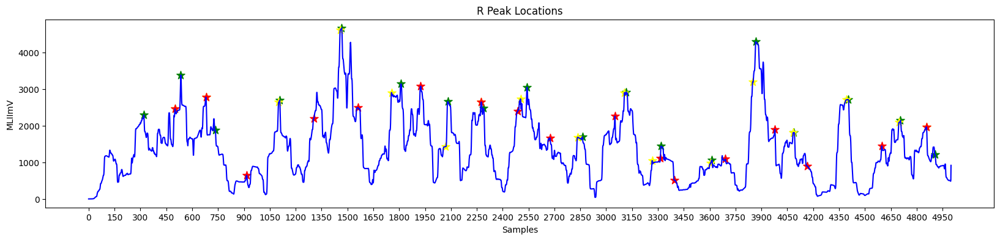

In [11]:
# Convert ecg signal to numpy array
lead_number=8
full_signal=load_mat_file(mat_path)
signal=load_mat_file(mat_path)[lead_number]
fs=500

processed_ecg=process_ecg(hea_dict,full_signal)[lead_number]
#signal = ecg.iloc[:,1].to_numpy()
signal=processed_ecg
# Find the R peak locations

#r_peaks=[518,1066,1615,2168,2712,3250,3790,4338,4884]

from scipy.signal import find_peaks
r_peaks,_ = find_peaks(signal, distance=200, height=0.5)
r_peaks = np.array(r_peaks)

p_peaks = find_p_peaks(signal, r_peaks, sampling_rate=500, p_wave_window=150)

t_peaks = find_t_peaks(signal, r_peaks)

r_peaks=r_peaks[1:]
p_peaks=p_peaks[1:]
t_peaks=t_peaks[1:]

print(r_peaks)
print(p_peaks)
print(t_peaks)



st_t,med_t=t_wave_mpe(signal,t_peaks)
print(st_t,"   ",med_t)

# Clip the x locations less than 0 (Learning Phase)
r_peaks = r_peaks[r_peaks > 0]

# Calculate the heart rate
h_rates=np.diff(r_peaks)
heartRate = (60*fs)/np.average(h_rates)
h_max= (60*fs)/np.min([x for x in h_rates if x != 0])
h_min = (60*fs)/np.max(h_rates)

print("Max BPM ",h_max)
print("Min BPM ",h_min)
print("Heart Rate",heartRate, "BPM")

# Plotting the R peak locations in ECG signal
plt.figure(figsize = (20,4), dpi = 100)
plt.xticks(np.arange(0, len(signal)+1, 150))
plt.plot(signal, color = 'blue')        
plt.scatter(r_peaks, signal[r_peaks], color = 'green', s = 100, marker= '*')
plt.scatter(p_peaks, signal[p_peaks], color = 'yellow', s = 100, marker= '*')
plt.scatter(t_peaks, signal[t_peaks], color = 'red', s = 100, marker= '*')
plt.xlabel('Samples')
plt.ylabel('MLIImV')
plt.title("R Peak Locations")


In [12]:
import numpy as np
from scipy.signal import find_peaks
from scipy.signal import correlate

def calculate_rr_intervals(r_peaks, samp_freq):
    """
    Calculate RR intervals (differences between successive R-peaks).
    
    :param r_peaks: List or array of R-peak positions (indices).
    :param samp_freq: Sampling frequency of the ECG signal (in Hz).
    :return: List of RR intervals in milliseconds.
    """
    # Calculate the differences between successive R-peaks (in samples)
    rr_intervals_samples = np.diff(r_peaks)
    
    # Convert RR intervals from samples to milliseconds
    rr_intervals_ms = rr_intervals_samples / samp_freq * 1000  # Multiply by 1000 to convert to ms
    
    return rr_intervals_ms

def calculate_mpe(signal, m, scale):
    """
    Calculate Multiscale Permutation Entropy (MPE) for a given scale.

    :param signal: Input 1D signal (e.g., T-wave portion of ECG).
    :param m: Embedding dimension for permutation entropy.
    :param scale: Scale factor for coarse-graining.
    :return: Permutation entropy value for the given scale.
    """
    # Coarse-grain the signal
    coarse_grained_signal = [np.mean(signal[i:i + scale]) for i in range(0, len(signal) - scale + 1, scale)]

    # Calculate permutation entropy
    perm_patterns = []
    for i in range(len(coarse_grained_signal) - m + 1):
        # Extract a pattern of length m
        pattern = coarse_grained_signal[i:i + m]
        # Generate a rank pattern (permutation)
        ranks = np.argsort(pattern)
        perm_patterns.append(tuple(ranks))
    
    # Calculate probabilities of unique patterns
    unique_patterns, counts = np.unique(perm_patterns, return_counts=True, axis=0)
    probabilities = counts / sum(counts)
    
    # Compute permutation entropy
    perm_entropy = -np.sum(probabilities * np.log(probabilities))
    return perm_entropy


def t_wave_mpe(ecg_signal, r_peaks, samp_freq, scales, m=3):
    """
    Calculate the standard deviation of T-wave Multiscale Permutation Entropy.

    :param ecg_signal: Full ECG signal.
    :param r_peaks: Indices of R-peaks in the ECG signal.
    :param samp_freq: Sampling frequency of the ECG signal.
    :param scales: List of scales for MPE calculation.
    :param m: Embedding dimension for permutation entropy.
    :return: Standard deviation of MPE values across scales.
    """
    # Identify T-wave region (150 ms to 300 ms after each R-peak)
    t_wave_regions = []
    for r_peak in r_peaks:
        start = r_peak + int(0.15 * samp_freq)  # 150 ms after R-peak
        end = r_peak + int(0.3 * samp_freq)    # 300 ms after R-peak
        if end < len(ecg_signal):
            t_wave_regions.append(ecg_signal[start:end])
    
    # Flatten T-wave regions into a single signal
    t_wave_signal = np.concatenate(t_wave_regions)

    # Calculate MPE for each scale
    mpe_values = []
    for scale in scales:
        mpe = calculate_mpe(t_wave_signal, m, scale)
        mpe_values.append(mpe)
    
    std_mpe=np.std(mpe_values)
    median_mpe=np.median(mpe_values)
    
    return std_mpe,median_mpe



def calculate_rr(rr_intervals):
    """
    Calculate the RMSSD (Root Mean Square of Successive Differences) from RR intervals.

    :param rr_intervals: List or array of RR intervals in milliseconds.
    :return: RMSSD value.
    """
    # Calculate successive differences of RR intervals
    diff_rr = np.diff(rr_intervals)
    
    # Square the differences
    squared_diff_rr = diff_rr ** 2
    
    # Calculate the mean of the squared differences
    mean_squared_diff = np.mean(squared_diff_rr)
    
    # Return the square root of the mean
    rmssd = np.sqrt(mean_squared_diff)
    rrmed=np.median(diff_rr)
    rrmin=np.min(diff_rr)
    return rmssd,rrmed,rrmin
# Return the standard deviation of MPE values
from scipy.stats import pearsonr
def compute_p_wave_correlation(ecg_signal, p_peaks, window_size=50):
    """
    Compute the P-wave correlation coefficient between individual P-waves and the template P-wave.

    :param ecg_signal: The ECG signal (array or list).
    :param p_peaks: List of P-peak indices.
    :param window_size: The window size around each P-peak to define the P-wave (in samples).
    :return: List of correlation coefficients for each P-wave with the template P-wave.
    """
    # Step 1: Extract P-wave segments
    p_waves = []
    for p_peak in p_peaks:
        start_idx = max(0, p_peak - window_size // 2)
        end_idx = min(len(ecg_signal), p_peak + window_size // 2)
        p_wave = ecg_signal[start_idx:end_idx]
        
        # Zero-pad if the segment size is smaller than the window size
        if len(p_wave) < window_size:
            p_wave = np.pad(p_wave, (0, window_size - len(p_wave)), mode='constant')
        
        p_waves.append(p_wave)
    
    # Step 2: Compute the template P-wave (average of all P-waves)
    p_wave_template = np.mean(p_waves, axis=0)
    
    # Step 3: Compute correlation coefficients
    correlation_coefficients = []
    for p_wave in p_waves:
        corr, _ = pearsonr(p_wave, p_wave_template)
        correlation_coefficients.append(corr)
    
    return np.mean(correlation_coefficients)

def calculate_pnn60(rr_intervals):
    """
    Calculate the PNN60 (Percentage of NN intervals > 60 ms) from RR intervals.

    :param rr_intervals: List or array of RR intervals in milliseconds.
    :return: PNN60 value (percentage).
    """
    # Calculate the differences between successive RR intervals
    diff_rr = np.diff(rr_intervals)
    
    # Count the number of differences greater than 60 ms
    count_gt_60 = np.sum(diff_rr > 60)
    
    # Calculate the total number of RR intervals
    total_rr_intervals = len(diff_rr)
    
    # Calculate PNN60 as the percentage of intervals greater than 60 ms
    pnn60 = (count_gt_60 / total_rr_intervals) * 100 if total_rr_intervals > 0 else 0
    
    return pnn60

def calculate_rr_fisher_information(rr_intervals):
    """
    Calculate the Fisher Information for the mean of the RR intervals.
    
    The Fisher Information for the mean of a normal distribution is given by:
        Fisher Information = 1 / variance
    
    :param rr_intervals: List or array of RR intervals in milliseconds.
    :return: Fisher Information value.
    """
    # Calculate the variance of the RR intervals
    variance = np.var(rr_intervals)
    
    # Fisher Information is the inverse of the variance
    fisher_information = 1 / variance if variance > 0 else 0
    
    return fisher_information


samp_freq = 500  # Sampling frequency (Hz)
scales = [1, 2, 3, 4, 5]  # Scales for MPE calculation
rr_interval=calculate_rr_intervals(r_peaks,samp_freq)

print("Max BPM ",h_max)
print("Min BPM ",h_min)
print("Heart Rate",heartRate, "BPM")

# Calculate standard deviation of T-wave MPE
std_mpe,median_mpe=t_wave_mpe(signal, r_peaks, samp_freq, scales)
print("Standard Deviation of T-wave MPE:", std_mpe)
print("Median of T-wave MPE:", median_mpe)

rmssd,rrmed,rrmin = calculate_rr(r_peaks)
print("RMSSD:", rmssd)
print("RR Interval Median:", rrmed)
print("RR Interval Minimum:", rrmin)

p_wave_corrs = compute_p_wave_correlation(signal, p_peaks)
print("P-wave Correlation Coefficients:", p_wave_corrs)

pnn60=calculate_pnn60(rr_interval)
print("PNN60 : ",pnn60)

fisher=calculate_rr_fisher_information(rr_interval)
print("Fisher Information : ",fisher)

Max BPM  150.0
Min BPM  80.42895442359249
Heart Rate 111.18378024852845 BPM
Standard Deviation of T-wave MPE: 0.06555789457770929
Median of T-wave MPE: 1.3574809263809662
RMSSD: 275.71841987582826
RR Interval Median: 256.0
RR Interval Minimum: 200
P-wave Correlation Coefficients: 0.5947119391692324
PNN60 :  31.25
Fisher Information :  7.773849308907487e-05


In [13]:
from tqdm import tqdm

complete_hea_dict=[]

for i in tqdm(range(len(hea_array))):
    if hea_array[i]==None:
        continue
    #complete_hea_dict.append(parse_header_file(hea_array[i]))
    
print(len(complete_hea_dict))
# pprint(complete_hea_dict)

100%|██████████| 21838/21838 [00:00<00:00, 8260751.33it/s]

0


In [14]:

import numpy as np
import pandas as pd
import scipy.io
import matplotlib.pyplot as plt
import sys
from scipy import signal as sg
from scipy.signal import find_peaks
from scipy.signal import correlate
import random

def load_mat_file(mat_path):
    # Load the .mat file using scipy.io
    mat_data = scipy.io.loadmat(mat_path)
    # Assuming the ECG signal is stored in 'ecg' key or similar
    ecg_signal = mat_data['val']  # Replace 'ecg' with the actual key if different
    return ecg_signal

def calculate_rr_intervals(r_peaks, samp_freq):
    """
    Calculate RR intervals (differences between successive R-peaks).
    
    :param r_peaks: List or array of R-peak positions (indices).
    :param samp_freq: Sampling frequency of the ECG signal (in Hz).
    :return: List of RR intervals in milliseconds.
    """
    # Calculate the differences between successive R-peaks (in samples)
    rr_intervals_samples = np.diff(r_peaks)
    
    # Convert RR intervals from samples to milliseconds
    rr_intervals_ms = rr_intervals_samples / samp_freq * 1000  # Multiply by 1000 to convert to ms
    
    return rr_intervals_ms

def compute_mpe(signal, m, delay, scales):
    """
    Compute Multiscale Permutation Entropy (MPE) for a given signal.
    
    :param signal: 1D array or list of signal values.
    :param m: Embedding dimension for PE.
    :param delay: Time delay for PE.
    :param scales: List of scales for multiscale PE calculation.
    :return: List of MPE values for each scale.
    """
    mpe_values = []
    for scale in scales:
        # Coarse-grain the signal for the current scale
        coarse_grained = np.mean(signal[:len(signal)//scale * scale].reshape(-1, scale), axis=1)
        # Compute Permutation Entropy for the coarse-grained signal
        mpe_values.append(ent.permutation_entropy(coarse_grained, order=m, delay=delay))
    return mpe_values

def t_wave_mpe(ecg_signal, t_peaks, fs=500, window_size=0.2, m=3, delay=1, scales=[1, 2, 3, 4, 5]):
    """
    Compute T-wave Multiscale Permutation Entropy (MPE) for an ECG signal.
    
    :param ecg_signal: The ECG signal (array or list).
    :param t_peaks: List of indices of T-peaks in the ECG signal.
    :param fs: Sampling frequency of the signal (in Hz).
    :param window_size: Time window around T-peak to extract T-wave (in seconds).
    :param m: Embedding dimension for PE.
    :param delay: Time delay for PE.
    :param scales: List of scales for multiscale PE calculation.
    :return: List of MPE values for each T-wave segment.
    """
    t_wave_mpe_values = []
    half_window_samples = int(window_size * fs / 2)  # Half-window size in samples
    
    for t_peak in t_peaks:
        # Define the window around the T-peak
        start_idx = max(0, t_peak - half_window_samples)
        end_idx = min(len(ecg_signal), t_peak + half_window_samples)
        
        # Extract the T-wave segment
        t_wave_segment = ecg_signal[start_idx:end_idx]
        
        # Resample the segment to a fixed length (if needed)
        if len(t_wave_segment) != 2 * half_window_samples:
            t_wave_segment = np.pad(
                t_wave_segment, 
                (0, 2 * half_window_samples - len(t_wave_segment)), 
                'constant'
            )
        
        # Calculate Multiscale Permutation Entropy for the T-wave segment
        mpe_values = compute_mpe(t_wave_segment, m=m, delay=delay, scales=scales)
        t_wave_mpe_values.append(mpe_values)
    
    return np.std(t_wave_mpe_values),np.mean(t_wave_mpe_values)

def calculate_rr(rr_intervals):
    """
    Calculate the RMSSD (Root Mean Square of Successive Differences) from RR intervals.

    :param rr_intervals: List or array of RR intervals in milliseconds.
    :return: RMSSD value.
    """
    
    if len(rr_intervals)==0:
        return 0,0,0
    
    # Calculate successive differences of RR intervals
    diff_rr = np.diff(rr_intervals)
    
    # Square the differences
    squared_diff_rr = diff_rr ** 2
    
    # Calculate the mean of the squared differences
    mean_squared_diff = np.mean(squared_diff_rr)
    
    # Return the square root of the mean
    rmssd = np.sqrt(mean_squared_diff)
    rrmed=np.median(diff_rr)
    rrmin=np.min(diff_rr)
    return rmssd,rrmed,rrmin

def find_p_peaks(ecg_signal, r_peaks, sampling_rate=500, p_wave_window=150):
    """
    Detect P-peaks in an ECG signal based on R-peak locations.

    :param ecg_signal: 1D array or list of the ECG signal.
    :param r_peaks: List of R-peak indices.
    :param sampling_rate: Sampling rate of the ECG signal in Hz.
    :param p_wave_window: Time window before each R-peak to search for P-peaks (in ms).
    :return: List of P-peak indices.
    """
    # Convert the P-wave window from ms to samples
    p_wave_window_samples = int((p_wave_window / 1000) * sampling_rate)
    p_peaks = []

    for r_peak in r_peaks:
        # Define the P-wave search region (before the R-peak)
        start_idx = max(0, r_peak - p_wave_window_samples)
        end_idx = r_peak

        # Extract the segment of the signal for P-wave detection
        p_wave_region = ecg_signal[start_idx:end_idx]

        # Detect peaks in the P-wave region
        peaks, _ = find_peaks(p_wave_region)

        if len(peaks) > 0:
            # Find the peak with the maximum amplitude (assume it corresponds to the P-wave)
            p_peak_idx = peaks[np.argmax(p_wave_region[peaks])]
            p_peaks.append(start_idx + p_peak_idx)

    return p_peaks

def find_t_peaks(ecg_signal, r_peaks, fs=500, t_window=(0.15, 0.4)):
    """
    Find T-peaks in an ECG signal.

    :param ecg_signal: The ECG signal (array or list).
    :param r_peaks: Indices of detected R-peaks.
    :param fs: Sampling frequency of the signal (in Hz).
    :param t_window: Time window after R-peaks to search for T-peaks (in seconds).
    :return: List of indices of T-peaks.
    """
    t_peaks = []
    search_start_offset = int(t_window[0] * fs)  # Convert seconds to samples
    search_end_offset = int(t_window[1] * fs)    # Convert seconds to samples

    for r_peak in r_peaks:
        # Define the search window for the T-wave
        search_start = r_peak + search_start_offset
        search_end = r_peak + search_end_offset

        # Ensure the search window is within signal bounds
        if search_start >= len(ecg_signal) or search_end > len(ecg_signal):
            break

        # Extract the segment where the T-wave is expected
        t_wave_segment = ecg_signal[search_start:search_end]

        # Find the index of the maximum amplitude in the segment
        t_peak_relative = np.argmax(t_wave_segment)
        t_peak = search_start + t_peak_relative

        t_peaks.append(t_peak)

    return t_peaks

def compute_p_wave_correlation(ecg_signal, p_peaks, window_size=50):
    """
    Compute the P-wave correlation coefficient between individual P-waves and the template P-wave.

    :param ecg_signal: The ECG signal (array or list).
    :param p_peaks: List of P-peak indices.
    :param window_size: The window size around each P-peak to define the P-wave (in samples).
    :return: List of correlation coefficients for each P-wave with the template P-wave.
    """
    # Step 1: Extract P-wave segments
    p_waves = []
    for p_peak in p_peaks:
        start_idx = max(0, p_peak - window_size // 2)
        end_idx = min(len(ecg_signal), p_peak + window_size // 2)
        p_wave = ecg_signal[start_idx:end_idx]
        
        # Zero-pad if the segment size is smaller than the window size
        if len(p_wave) < window_size:
            p_wave = np.pad(p_wave, (0, window_size - len(p_wave)), mode='constant')
        
        p_waves.append(p_wave)
    
    # Step 2: Compute the template P-wave (average of all P-waves)
    p_wave_template = np.mean(p_waves, axis=0)
    
    # Step 3: Compute correlation coefficients
    correlation_coefficients = []
    for p_wave in p_waves:
        corr, _ = pearsonr(p_wave, p_wave_template)
        correlation_coefficients.append(corr)
    
    return np.mean(correlation_coefficients)

def calculate_rr_fisher_information(rr_intervals):
    """
    Calculate the Fisher Information for the mean of the RR intervals.
    
    The Fisher Information for the mean of a normal distribution is given by:
        Fisher Information = 1 / variance
    
    :param rr_intervals: List or array of RR intervals in milliseconds.
    :return: Fisher Information value.
    """
    # Calculate the variance of the RR intervals
    variance = np.var(rr_intervals)
    
    # Fisher Information is the inverse of the variance
    fisher_information = 1 / variance if variance > 0 else 0
    
    return fisher_information

def check_gender(s):
    s = s.lower()  # Convert the string to lowercase for case-insensitive comparison
    if 'male' in s:
        return 0
    elif 'female' in s:
        return 1
    else:
        return random.choice([0, 1])

def check_age(s):
    # Try to find an integer in the string
    numbers = [int(word) for word in s.split() if word.isdigit()]
    
    if numbers:
        return numbers[0]  # Return the first integer found
    else:
        return random.randint(20, 95)
    
def get_10_seconds(signal,fs=500):
    sampled=[]
    for lead in signal:
        sampled.append(get_random_10s_segment(lead,sampling_rate=fs))
    return np.array(sampled)
        
        
def get_random_10s_segment(ecg_signal, sampling_rate=500):
    # Calculate the number of samples for 15 seconds
    num_samples = int(10 * sampling_rate)
    
    # Check if the signal is shorter than 15 seconds
    if len(ecg_signal) < num_samples:
        # Apply zero-padding
        padded_signal = np.zeros(num_samples)
        padded_signal[:len(ecg_signal)] = ecg_signal
        return padded_signal
    elif len(ecg_signal)==num_samples:
        return ecg_signal
    else:
        return ecg_signal[0:num_samples]


In [15]:
def calculate_labels(file_index,hea_array,mat_array,valid_disease):
    hea_dict=parse_header_file(hea_array[file_index])
    signal_org = load_mat_file(mat_array[file_index])
    
    # pprint(signal_org)
    
    disease=(hea_dict["Patient_Info"]["Diagnosis_Code"]).split(',')
    age=hea_dict["Patient_Info"]["Age"]
    gender=hea_dict["Patient_Info"]["Sex"]
    fs = hea_dict['Sampling_Rate_Hz']
    
    signal= get_10_seconds(signal_org,fs=fs)
    
    print(signal.shape)
    # print(signal)

    
    features=[]
    for i in range(len(signal)):
        feat=calculate_each_signal(signal[i],fs)
        features.append(feat)
        
    features = list(map(list, zip(*features)))
    
    classify=[np.mean(fe) for fe in features]
    ag=check_age(age)
    ge=check_gender(gender)
    classify.append(ag)
    classify.append(ge)
    
    presence=[]
    
    for dis in valid_disease:
        if any(dis.lower() in s.lower() for s in disease):
            presence.append(1)
        else:
            presence.append(0)
    
    return signal,classify,presence
    
def calculate_each_signal(signal,fs):
    samp_freq=fs
    
    r_peaks,_ = find_peaks(signal, distance=200, height=0.5)
    r_peaks = np.array(r_peaks)
    r_peaks = r_peaks[r_peaks > 0]
    
    if len(r_peaks)==0:
        return [0.0 for _ in range(10)]
    
    p_peaks = find_p_peaks(signal, r_peaks, sampling_rate=fs)

    t_peaks=find_t_peaks(signal,r_peaks, fs=fs)
    
    r_peaks=r_peaks[1:]
    p_peaks=p_peaks[1:]
    t_peaks=t_peaks[1:]
    
    # Calculate the heart rate
    h_rates=np.diff(r_peaks)
    
    
    if len(h_rates)==0:
        h_mean=0
        h_max=0
        h_min=0
    else:
        h_rates=h_rates*2
        h_mean = (60*fs)/np.average(h_rates)
        h_max= (60*fs)/np.min([x for x in h_rates if x != 0])
        h_min = (60*fs)/np.max(h_rates)
    
    rr_interval=calculate_rr_intervals(r_peaks,samp_freq)
    std_mpe,median_mpe=t_wave_mpe(signal, t_peaks)
    rmssd,rrmed,rrmin = calculate_rr(r_peaks)
    
    
    p_wave_corrs = compute_p_wave_correlation(signal, p_peaks)
    
    fisher=calculate_rr_fisher_information(rr_interval)
    
    features=[h_min,std_mpe,h_max,median_mpe,rmssd,p_wave_corrs,rrmed,h_mean,fisher,rrmin]
    features=[0 if (np.isnan(x) or np.isinf(x)) else x for x in features]


    plt.figure(figsize = (20,4), dpi = 100)
    plt.xticks(np.arange(0, len(signal)+1, 150))
    plt.plot(signal, color = 'blue')        
    plt.scatter(r_peaks, signal[r_peaks], color = 'green', s = 100, marker= '*')
    plt.scatter(p_peaks, signal[p_peaks], color = 'yellow', s = 100, marker= '*')
    plt.scatter(t_peaks, signal[t_peaks], color = 'red', s = 100, marker= '*')
    plt.xlabel('Samples')
    plt.ylabel('MLIImV')
    plt.title("R Peak Locations")
    
    return features

(12, 5000)


/mnt/Installation/Virtual_Environment/Python3_11/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/mnt/Installation/Virtual_Environment/Python3_11/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/mnt/Installation/Virtual_Environment/Python3_11/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/mnt/Installation/Virtual_Environment/Python3_11/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/mnt/Installation/Virtual_Environment/Python3_11/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret =

(12, 5000)
12
5
[29.49235403705481,
 0.2984543785188453,
 52.52094348054822,
 1.2778884794114282,
 296.8743427646296,
 0.5958562176818925,
 294.7083333333333,
 35.95732796318667,
 0.00024976117257266664,
 209.75,
 85,
 0]
[0, 1, 0, 0, 0]
{'Age': 85,
 'Gender (Male:0, Female:1)': 0,
 'Max HR': 52.52094348054822,
 'Mean HR': 35.95732796318667,
 'Min HR': 29.49235403705481,
 'P wave correlation coefficient': 0.5958562176818925,
 'RMSSD': 296.8743427646296,
 'RR interval (Mean)': 209.75,
 'RR interval (Median)': 294.7083333333333,
 'RR interval Fisher information': 0.00024976117257266664,
 'T wave permutation entropy (Median)': 1.2778884794114282,
 'T wave permutation entropy (STD)': 0.2984543785188453}


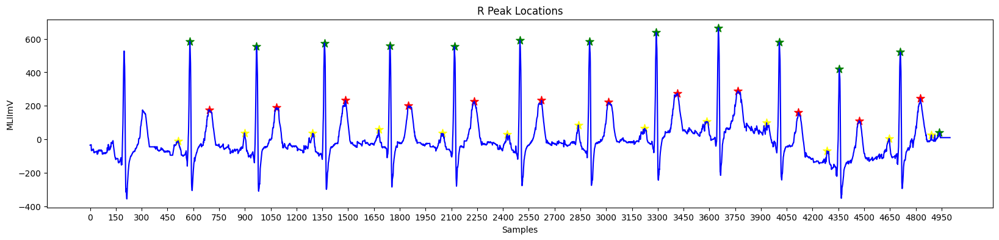

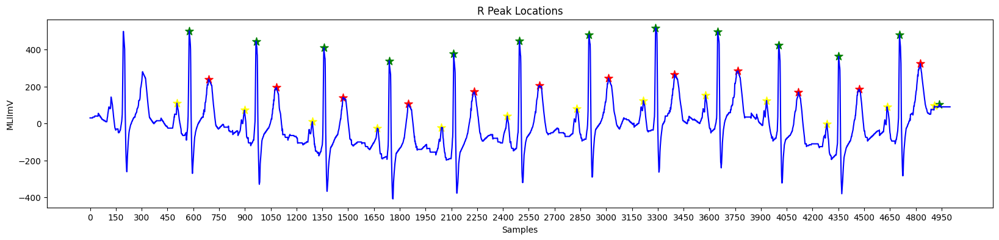

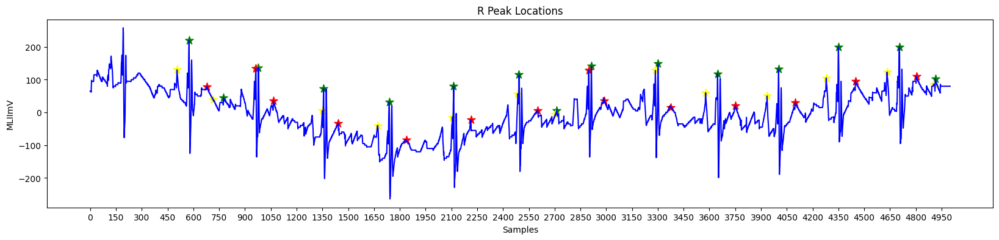

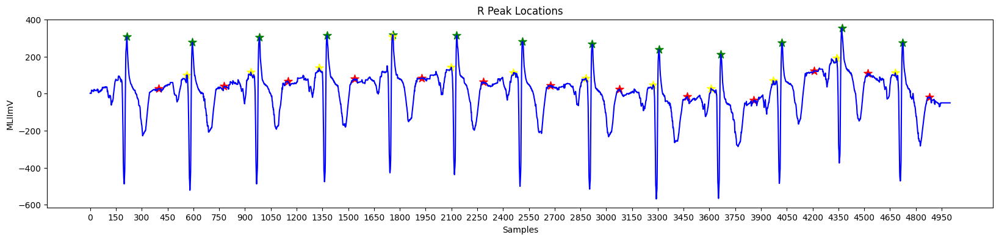

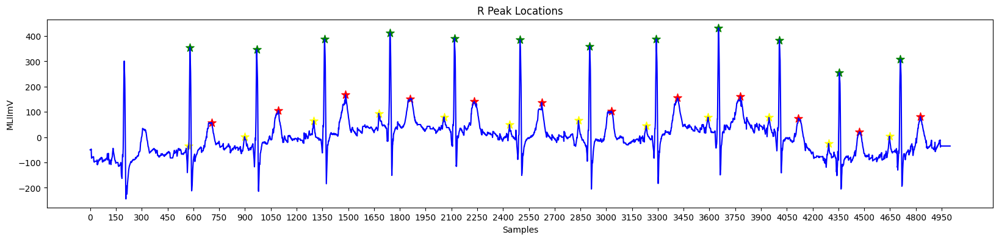

...

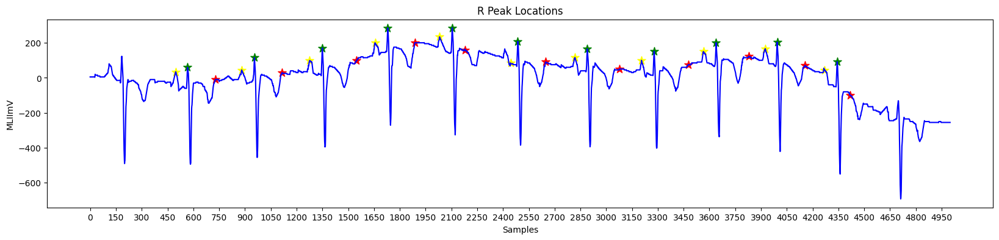

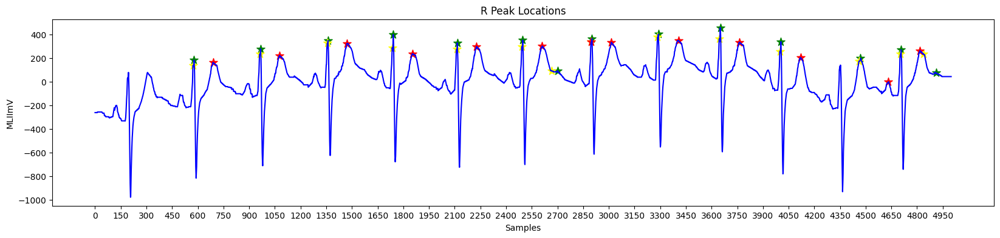

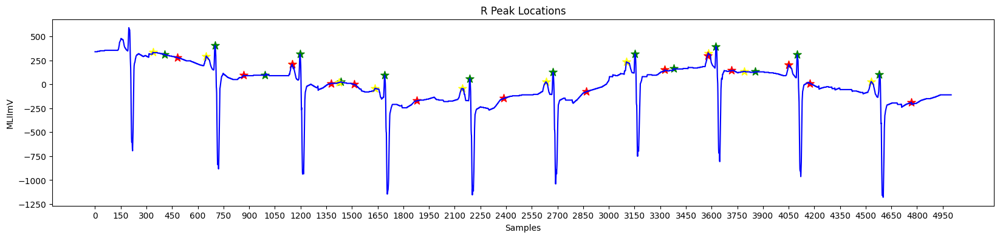

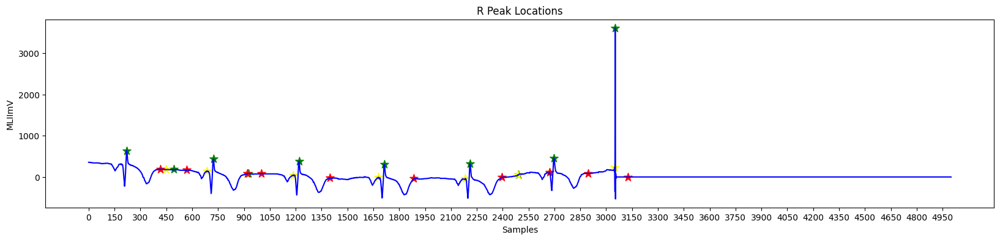

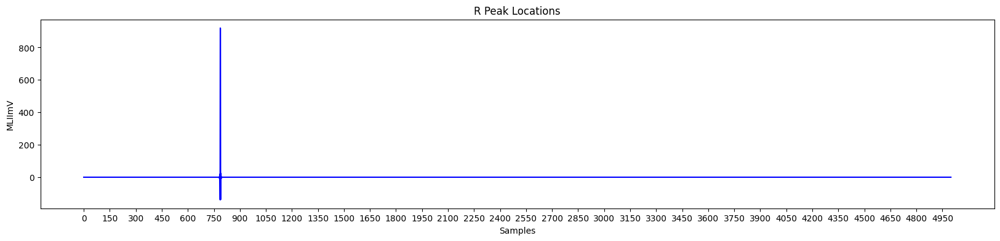

In [16]:

test_number=12722
valid_disease=["426783006","164865005","39732003","164951009","164873001"]

signal,features,labels=calculate_labels(test_number,hea_array,mat_array,valid_disease)

print(signal.shape)
print(len(features))
print(len(labels))

pprint(features)
pprint(labels)

feat_dict_key = ['Min HR', 'T wave permutation entropy (STD)',
            'Max HR', 'T wave permutation entropy (Median)', 'RMSSD',
            'P wave correlation coefficient', 
            'RR interval (Median)', 'Mean HR', 'RR interval Fisher information',
            'RR interval (Mean)','Age','Gender (Male:0, Female:1)']

# Create a dictionary to map feature names to their corresponding values
feature_dict = dict(zip(feat_dict_key, features))

pprint(feature_dict)



In [ ]:
import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
import math
import numpy as np
from torch.autograd import Variable
from sklearn.metrics import roc_auc_score

# Define the Noam optimizer (as explained earlier)
class NoamOpt:
    def __init__(self, model, warmup_steps, factor=1, optimizer=None):
        self.model = model
        self.warmup_steps = warmup_steps
        self.factor = factor
        self.optimizer = optimizer if optimizer else optim.Adam(model.parameters(), lr=1e-4)
        self.step_num = 0

    def rate(self):
        """Calculate the learning rate based on the Noam scheduler."""
        if self.step_num < self.warmup_steps:
            return self.factor * (self.step_num + 1) / self.warmup_steps
        else:
            return self.factor * (self.step_num + 1) ** -0.5

    def step(self):
        """Update the model's parameters."""
        self.step_num += 1
        lr = self.rate()
        for param_group in self.optimizer.param_groups:
            param_group['lr'] = lr
        self.optimizer.step()

    def zero_grad(self):
        """Clear gradients for the optimizer."""
        self.optimizer.zero_grad()


# Define your model architecture (CTN model and Transformer as already defined)
class PositionalEncoding(nn.Module):
    def __init__(self, d_model, dropout, max_len=5000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * -(math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + Variable(self.pe[:, :x.size(1)], requires_grad=False)
        #x = x + self.pe[:, :x.size(1)]
        return self.dropout(x)

class Transformer(nn.Module):
    def __init__(self, d_model, nhead, d_ff, num_layers, dropout):
        super(Transformer, self).__init__()
        self.d_model = d_model
        self.h = nhead
        self.d_ff = d_ff
        self.num_layers = num_layers
        
        # Add dropout to the encoder layers
        self.pe = PositionalEncoding(d_model, dropout)

        # Transformer Encoder Layer
        encode_layer = nn.TransformerEncoderLayer(
            d_model=self.d_model, 
            nhead=self.h, 
            dim_feedforward=self.d_ff, 
            dropout=dropout
        )
        self.transformer_encoder = nn.TransformerEncoder(encode_layer, self.num_layers)

    def forward(self, x):
        # Permute dimensions to match Transformer expectations: (batch_size, seq_len, d_model)
        out = x.permute(0, 2, 1)
        out = self.pe(out)  # Add positional encoding
        out = out.permute(1, 0, 2)  # Permute back for transformer encoder
        out = self.transformer_encoder(out)
        out = out.mean(0)  # Global average pooling over sequence length
        return out


class CTN(nn.Module):
    def __init__(self, d_model, nhead, d_ff, num_layers, dropout_rate, deepfeat_sz, nb_feats, classes):
        super(CTN, self).__init__()
        
        self.encoder = nn.Sequential(
            nn.Conv1d(12, 128, kernel_size=14, stride=3, padding=2, bias=False),
            nn.BatchNorm1d(128),
            nn.ReLU(inplace=True),
            nn.Conv1d(128, 256, kernel_size=14, stride=3, padding=0, bias=False),
            nn.BatchNorm1d(256),
            nn.ReLU(inplace=True),
            nn.Conv1d(256, d_model, kernel_size=10, stride=2, padding=0, bias=False),
            nn.BatchNorm1d(d_model),
            nn.ReLU(inplace=True),
            nn.Conv1d(d_model, d_model, kernel_size=10, stride=2, padding=0, bias=False),
            nn.BatchNorm1d(d_model),
            nn.ReLU(inplace=True),
            nn.Conv1d(d_model, d_model, kernel_size=10, stride=1, padding=0, bias=False),
            nn.BatchNorm1d(d_model),
            nn.ReLU(inplace=True),
            nn.Conv1d(d_model, d_model, kernel_size=10, stride=1, padding=0, bias=False),
            nn.BatchNorm1d(d_model),
            nn.ReLU(inplace=True)
        )
        self.transformer = Transformer(d_model, nhead, d_ff, num_layers, dropout=0.1)
        self.fc1 = nn.Linear(d_model, deepfeat_sz)
        self.fc2 = nn.Linear(deepfeat_sz + nb_feats, len(classes))
        self.dropout = nn.Dropout(dropout_rate)

    def forward(self, x, wide_feats):
        z = self.encoder(x)  # Encoded sequence
        out = self.transformer(z)  # Transformer output
        out = self.dropout(F.relu(self.fc1(out)))
        out = self.fc2(torch.cat([wide_feats, out], dim=1))
        return out


# Generate some random training data for testing purposes


n_train = 100
ecg_train = torch.randn(n_train, 12, 5000)  # Random ECG data (n, 12, 5000)
wide_feats_train = torch.randn(n_train, 2)  # Random wide features (age, gender)
y_train = torch.randint(0, 2, (n_train, 5))  # Random binary labels for multi-label classification




# Create DataLoader for training
train_dataset = TensorDataset(ecg_train, wide_feats_train, y_train)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# Hyperparameters
d_model = 256
nhead = 8
d_ff = 512
num_layers = 8
dropout_rate = 0.1
deepfeat_sz = 64
nb_feats = 2
classes = [0, 1, 2, 3, 4]  # 5 classes
warmup_steps = 4000  # Number of warm-up steps for the Noam optimizer
epochs = 10  # Number of training epochs

# Initialize model, loss function, and optimizer
model = CTN(d_model=d_model, nhead=nhead, d_ff=d_ff, num_layers=num_layers,
            dropout_rate=dropout_rate, deepfeat_sz=deepfeat_sz,
            nb_feats=nb_feats, classes=classes)

# Create Adam optimizer
optimizer = optim.Adam(model.parameters(), lr=1e-4, betas=(0.9, 0.98), eps=1e-9)

# Use Noam optimizer
noam_optimizer = NoamOpt(model, warmup_steps, optimizer=optimizer)

# Loss function
criterion = nn.BCEWithLogitsLoss()

# Training loop
for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    correct_preds = 0
    total_preds = 0
    
    for batch in train_loader:
        ecg_signal, wide_feats, labels = batch
        noam_optimizer.zero_grad()  # Zero gradients
        
        # Forward pass
        outputs = model(ecg_signal, wide_feats)
        
        # Compute loss
        loss = criterion(outputs, labels.float())
        loss.backward()  # Backpropagation
        
        # Step the Noam optimizer (updates learning rate and performs optimization)
        noam_optimizer.step()

        running_loss += loss.item()
        
        # Calculate accuracy
        predicted = torch.sigmoid(outputs) > 0.5
        correct_preds += (predicted == labels).sum().item()
        total_preds += labels.numel()

    avg_loss = running_loss / len(train_loader)
    accuracy = correct_preds / total_preds * 100
    print(f"Epoch {epoch+1}/{epochs}, Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%")

# Test loop (using random test data for demonstration)
n_test = 50
ecg_test = torch.randn(n_test, 12, 5000)  # Random ECG test data
wide_feats_test = torch.randn(n_test, 2)  # Random wide features
y_test = torch.randint(0, 2, (n_test, 5))  # Random binary labels for testing

# Create DataLoader for test
test_dataset = TensorDataset(ecg_test, wide_feats_test, y_test)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# Testing the model
model.eval()
predictions = []
labels_list = []

with torch.no_grad():  # No need to track gradients during testing
    for batch in test_loader:
        ecg_signal, wide_feats, labels = batch
        outputs = model(ecg_signal, wide_feats)
        
        # Store the predictions and ground truth
        predictions.append(torch.sigmoid(outputs).cpu().numpy())
        labels_list.append(labels.cpu().numpy())

# Convert predictions and labels to numpy arrays
predictions = np.concatenate(predictions, axis=0)
labels_list = np.concatenate(labels_list, axis=0)

# Calculate ROC AUC score for multi-label classification
roc_auc = roc_auc_score(labels_list, predictions, average='macro', multi_class='ovr')
print(f"Test ROC AUC: {roc_auc:.4f}")


/mnt/Installation/Virtual_Environment/Python3_11/lib/python3.11/site-packages/torch/nn/modules/transformer.py:379: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(


Epoch 1/10, Loss: 0.7081, Accuracy: 49.00%
Epoch 2/10, Loss: 0.6926, Accuracy: 52.80%
Epoch 3/10, Loss: 0.6937, Accuracy: 52.20%
Epoch 4/10, Loss: 0.6988, Accuracy: 50.60%


In [7]:
import numpy as np
from pprint import pprint
memmap_path='/mnt/Velocity_Vault/ECG/Dataset/'
train_signal=np.memmap(memmap_path+'ecg_signal', dtype='int16', mode='r', shape=(21837, 12,5000))
np.set_printoptions(threshold=np.inf)
pprint(train_signal[:50])

memmap([[[ -115,  -115,  -115,  -115,  -115,  -115,  -115,  -117,  -109,
           -108,  -130,  -127,  -121,  -120,  -120,  -120,  -112,  -109,
           -111,  -109,  -105,  -105,  -103,   -98,   -95,   -95,   -95,
            -93,  -101,  -120,  -130,  -122,  -117,  -111,  -105,  -105,
            -93,   -84,   -74,   -63,   -55,   -43,   -36,   -35,   -35,
            -35,   -39,   -40,   -41,   -47,   -45,   -15,   -11,   -29,
             -7,    35,   -27,   -37,   -10,    -4,     5,    20,   -28,
            -76,   -88,  -110,  -136,  -145,  -145,  -145,  -145,  -144,
           -155,  -160,  -154,  -155,  -155,  -155,  -155,  -155,  -150,
           -138,  -128,  -121,  -113,  -105,  -100,  -104,  -119,  -149,
           -180,  -174,  -163,  -156,  -148,  -145,  -159,  -185,  -214,
           -215,  -175,  -145,   -96,   -68,   -43,    15,    41,   168,
            278,   307,   365,   466,   543,   546,   524,   490,   320,
            210,   142,    54,    -5,   -12,    -6,

In [21]:
import matplotlib.pyplot as plt
import  numpy as np
def plot_list(data,xx,yy,tit):
    plt.plot(data)
    plt.xlabel(xx)
    plt.ylabel(yy)
    plt.title(tit)
    plt.grid(True)
    plt.show()

# Example usage:
data = [8.0942, 2.2865, 0.4602, 0.3343, 0.2776, 0.2547, 0.2400, 0.2306, 0.2197, 0.2143, 0.2072, 0.2013, 0.1939, 0.1887, 0.1826, 0.1765, 0.1697, 0.1643, 0.1561, 0.1497, 0.1445, 0.1348, 0.1291, 0.1211, 0.1137, 0.1069, 0.0989, 0.0918, 0.0863, 0.0824, 0.0762, 0.0715, 0.0677, 0.0634, 0.0586, 0.0554, 0.0528, 0.0501, 0.0456, 0.0430, 0.0422, 0.0421, 0.0381, 0.0388, 0.0350, 0.0350, 0.0333, 0.0329, 0.0301, 0.0302]
# Replace with your data list
xx='Epoch'
yy='Error'
tit='Loss vs Epoch'
# plot_list(data,xx,yy,tit)
print(abs(np.diff(data)))
xx='Epoch'
yy='Percentage'
tit='Accuracy vs Epoch'

av=[53.35, 70.20, 82.12, 86.71, 88.85, 89.74, 90.41, 90.73, 91.20, 91.41, 91.70, 91.98, 92.29, 92.48, 92.85, 93.11, 93.30, 93.56, 93.91, 94.23, 94.42, 94.81, 95.11, 95.38, 95.64, 95.92, 96.34, 96.56, 96.77, 96.95, 97.15, 97.33, 97.50, 97.66, 97.87, 97.97, 98.07, 98.17, 98.35, 98.44, 98.51, 98.45, 98.60, 98.61, 98.74, 98.74, 98.81, 98.81, 98.93, 98.89]

# plot_list(av,xx,yy,tit)

[5.8077e+00 1.8263e+00 1.2590e-01 5.6700e-02 2.2900e-02 1.4700e-02
 9.4000e-03 1.0900e-02 5.4000e-03 7.1000e-03 5.9000e-03 7.4000e-03
 5.2000e-03 6.1000e-03 6.1000e-03 6.8000e-03 5.4000e-03 8.2000e-03
 6.4000e-03 5.2000e-03 9.7000e-03 5.7000e-03 8.0000e-03 7.4000e-03
 6.8000e-03 8.0000e-03 7.1000e-03 5.5000e-03 3.9000e-03 6.2000e-03
 4.7000e-03 3.8000e-03 4.3000e-03 4.8000e-03 3.2000e-03 2.6000e-03
 2.7000e-03 4.5000e-03 2.6000e-03 8.0000e-04 1.0000e-04 4.0000e-03
 7.0000e-04 3.8000e-03 0.0000e+00 1.7000e-03 4.0000e-04 2.8000e-03
 1.0000e-04]


In [3]:
from graphviz import Digraph

# Create a Digraph object
dot = Digraph()

# Noam Optimizer
dot.node('NoamOpt', 'Noam Optimizer')
dot.node('Init', 'Initialize\n- model\n- warmup_steps\n- factor\n- optimizer')
dot.node('Rate', 'rate()\n- Calculate LR\n  based on step')
dot.node('Step', 'step()\n- Update params\n- Adjust LR')
dot.node('ZeroGrad', 'zero_grad()\n- Clear gradients')

# CTN Model
dot.node('CTN', 'CTN Model')
dot.node('Encoder', 'Encoder\n- Conv1d Layers\n- BatchNorm1d\n- ReLU')
dot.node('Transformer', 'Transformer\n- PositionalEncoding\n- TransformerEncoder')
dot.node('FC', 'Fully Connected\n- fc1: Linear\n- fc2: Linear\n- Dropout')
dot.node('Output', 'Output\n- Predictions')

# Transformer
dot.node('PosEnc', 'PositionalEncoding\n- Dropout\n- Sin/Cos Encoding')
dot.node('TransEnc', 'TransformerEncoder\n- MultiheadAttention\n- Feedforward\n- LayerNorm\n- Dropout')
dot.node('GlobalPool', 'Global Avg Pooling')

# Add edges for Noam Optimizer
dot.edges([('NoamOpt', 'Init'), ('Init', 'Rate'), ('Rate', 'Step'), ('Step', 'ZeroGrad')])

# Add edges for CTN Model
dot.edges([('CTN', 'Encoder'), ('Encoder', 'Transformer'), ('Transformer', 'FC'), ('FC', 'Output')])

# Add edges for Transformer
dot.edges([('Transformer', 'PosEnc'), ('PosEnc', 'TransEnc'), ('TransEnc', 'GlobalPool')])

# Render the graph as a JPG image
dot.render('ctn_model_flowchart', format='jpg', cleanup=True)

'ctn_model_flowchart.jpg'